###  Scenario

#### UC00190 – Accessible Parking Availability Tracker

In the City of Melbourne, accessible parking is a critical resource for residents and visitors living with mobility impairments. However, these designated bays are often difficult to locate in real time, and occupancy can vary dramatically depending on time of day, location, and nearby events.

The City of Melbourne has deployed an advanced sensor network that monitors individual parking bays. These sensors, when combined with parking restriction data, provide a powerful foundation to develop a smart, real-time parking availability system targeted specifically at accessible (disabled-only) parking spaces.

This use case proposes a live dashboard that identifies the location and occupancy status of disability bays across the municipality. The project leverages existing open datasets to improve urban mobility, reduce the stress of finding suitable parking, and promote more inclusive city infrastructure.


###  Introduction

People living with disabilities often face disproportionate challenges when accessing transport services. One of the persistent frustrations in urban environments is the uncertainty around whether accessible parking bays are vacant — especially in high-demand or event-heavy areas of the city.

The City of Melbourne publishes several open datasets that, when combined, can offer real-time insight into these bays:
- **On-Street Car Park Bay Restrictions**: includes bay types, restriction classes, and disability-specific metadata.
- **On-Street Parking Bay Sensors**: provides up-to-the-minute occupancy status (e.g., Present or Unoccupied) for each bay.

By merging these datasets, this project will:
- Extract and visualise only **disabled-only** parking bays.
- Display their current occupancy status.
- Map their locations for user reference.
- Optionally identify patterns in usage or enforcement opportunities.

This use case sits at the intersection of **transport equity**, **real-time IoT data**, and **urban accessibility analytics**, offering tangible value to end-users and city decision-makers alike.


In [32]:
import numpy as np 
import pandas as pd 
import seaborn as sns
import matplotlib.pyplot as plt
import requests
import os
from functools import reduce
import folium
from folium.plugins import HeatMap
from folium.plugins import MarkerCluster
from dotenv import load_dotenv
from ipywidgets import Tab, VBox, HTML, Output


# RT ACCESSIBLE PARKING – 1.1

### Visualising On-Street Accessible Parking Bays

This visualisation shows where accessible (disability) parking bays are located across Melbourne streets.

By using open data provided by the City of Melbourne, we can download a list of all known accessible bays and display them on an interactive map. Each marker shows which street it’s on and when it was last updated.

This tool can help residents, planners, and visitors quickly see where accessible parking is available — and identify gaps in coverage.


## Step 1: Get Accessible Parking Data from the City of Melbourne

This step connects to the City of Melbourne's open data system and downloads a list of accessible (disability) parking bays across the city. 

The code automatically collects all available entries, even if there are thousands of them. It’s like going through the whole database a few pages at a time and saving everything into a table for us to use later.


In [33]:
!pip install python-dotenv


In [34]:
def fetch_parking_dataset(base_url, dataset_id, api_key=None, limit=100, max_pages=100):
    """
    Downloads and aggregates data from City of Melbourne’s Open Data API using paginated requests.
    
    Parameters:
        base_url (str): Base API URL.
        dataset_id (str): Dataset endpoint name.
        api_key (str): Optional API key. If not provided, will try to use MELBOURNE_API_KEY from environment.
        limit (int): Number of records per page (maximum 100).
        max_pages (int): Maximum number of pages to fetch to prevent infinite loops.
        
    Returns:
        pd.DataFrame: All records combined into a DataFrame.
    """
    api_key = api_key or os.environ.get("MELBOURNE_API_KEY")
    if not api_key:
        raise ValueError("API key is required. Set MELBOURNE_API_KEY in your environment or pass it directly.")

    all_results = []

    for page in range(max_pages):
        offset = page * limit
        url = f"{base_url}{dataset_id}/records?limit={limit}&offset={offset}&api_key={api_key}"

        try:
            response = requests.get(url, timeout=10)
            response.raise_for_status()
            data = response.json().get("results", [])
        except requests.exceptions.RequestException as e:
            print(f"Page {page + 1} failed: {e}")
            break

        if not data:
            break  # No more data to fetch

        all_results.extend(data)

        if len(data) < limit:
            break  # Reached the final page

    return pd.DataFrame(all_results)


# Set up the access details for the data website
load_dotenv()
API_KEY = os.environ.get("MELBOURNE_API_KEY")  # Gets your private API key from your computer
BASE_URL = 'https://data.melbourne.vic.gov.au/api/explore/v2.1/catalog/datasets/'


## Step 2: Load the Accessible Parking Bay Data

This step tells the program which dataset to get. We’re using the one called `on-street-parking-bays`, which lists all bays on Melbourne streets — including info like the street name, type of parking, and restrictions.

The table preview shows the first few rows.


In [35]:
# Step 2: Define which accessible dataset to download
dataset_accessible = 'on-street-parking-bays'

# Fetch and load the accessible parking bays dataset
df_bays = fetch_parking_dataset(
    base_url=BASE_URL,
    dataset_id=dataset_accessible,
    api_key=API_KEY,
    limit=100,               # Max allowed per API
    max_pages=100            # Adjust based on size of dataset
)

# Print the number of accessible parking bays retrieved
print("Accessible Bays Loaded:", df_bays.shape)

# Display a preview of the data
df_bays.head()


Accessible Bays Loaded: (10000, 7)


,roadsegmentid,kerbsideid,roadsegmentdescription,latitude,longitude,lastupdated,location
0,23322,None,Docklands Drive between Docklands Drive and We...,-37.816019,144.935552,2023-10-31,"{'lon': 144.9355523, 'lat': -37.8160191}"
1,22124,None,Hartley Street between Lorimer Street and West...,-37.824862,144.940270,2023-10-31,"{'lon': 144.9402698, 'lat': -37.8248623}"
2,22124,None,Hartley Street between Lorimer Street and West...,-37.824362,144.940408,2023-10-31,"{'lon': 144.9404083, 'lat': -37.8243625}"
3,22124,None,Hartley Street between Lorimer Street and West...,-37.824469,144.940379,2023-10-31,"{'lon': 144.9403789, 'lat': -37.8244685}"
4,22124,None,Hartley Street between Lorimer Street and West...,-37.824325,144.940188,2023-10-31,"{'lon': 144.9401876, 'lat': -37.8243252}"


## Step 3: Prepare Parking Bay Data for Mapping

This step keeps only the rows that have valid latitude and longitude values. These are the coordinates we need to show each bay on a map.


In [36]:
# Only keep rows that have both latitude and longitude values
df_bays = df_bays[df_bays['latitude'].notnull() & df_bays['longitude'].notnull()].copy()

# Convert coordinates to float just to be sure
df_bays['latitude'] = df_bays['latitude'].astype(float)
df_bays['longitude'] = df_bays['longitude'].astype(float)

# Preview just a few key columns
df_bays[['roadsegmentdescription', 'latitude', 'longitude']].head()


,roadsegmentdescription,latitude,longitude
0,Docklands Drive between Docklands Drive and We...,-37.816019,144.935552
1,Hartley Street between Lorimer Street and West...,-37.824862,144.940270
2,Hartley Street between Lorimer Street and West...,-37.824362,144.940408
3,Hartley Street between Lorimer Street and West...,-37.824469,144.940379
4,Hartley Street between Lorimer Street and West...,-37.824325,144.940188


## Step 4: Show Accessible Parking Bays on a Map

This step displays an interactive map of Melbourne with a marker for each on-street parking bay. 

When you click a marker, you’ll see the location name and road segment info in a popup. This makes it easy to visually explore where accessible parking is located across the city.


In [37]:
# Create a base map centered on Melbourne
m = folium.Map(location=[-37.8136, 144.9631], zoom_start=14, tiles="CartoDB positron")

# Add clustering so overlapping markers are grouped nicely
marker_cluster = MarkerCluster().add_to(m)

# Add each bay to the map
for _, row in df_bays.iterrows():
    popup_info = f"""
    <strong>Location:</strong> {row['roadsegmentdescription']}<br>
    <strong>Last Updated:</strong> {row['lastupdated']}
    """
    folium.Marker(
        location=[row['latitude'], row['longitude']],
        popup=folium.Popup(popup_info, max_width=250),
        icon=folium.Icon(color="blue", icon="info-sign")
    ).add_to(marker_cluster)

# Show the map
m


# RT ACCESSIBLE PARKING – 1.2

### Mapping Off-Street Car Parks with Accessibility Info

This visualisation shows all known off-street car parks in Melbourne — including whether they have accessible bays, how many total spaces they offer, and when they’re open.

Each car park is shown as a marker on the map. You can click each marker to see important details like the number of accessible bays, total capacity, and street address.

This helps highlight which facilities offer inclusive access and where improvements might be needed.


## Step 1: Load Off-Street Car Park Data from the City of Melbourne

This step downloads all off-street car park locations in Melbourne — including their capacity, opening hours, and accessible parking features.


In [38]:
# Step 1: Define which off-street car park dataset to download
dataset_offstreet = 'off-street-car-parks-with-capacity-and-type'

# Fetch and load the off-street car park dataset
df_offstreet = fetch_parking_dataset(
    base_url=BASE_URL,
    dataset_id=dataset_offstreet,
    api_key=API_KEY,
    limit=100,             # Max allowed per API
    max_pages=100          # Adjust based on dataset size
)

# Print the number of off-street car parks retrieved
print("Off-Street Car Parks Loaded:", df_offstreet.shape)

# Display a preview of the data
df_offstreet.head()


Off-Street Car Parks Loaded: (10000, 11)


,census_year,block_id,property_id,base_property_id,building_address,clue_small_area,parking_type,parking_spaces,longitude,latitude,location
0,2003,356,104125,104125,4 Gardiner Street NORTH MELBOURNE 3051,North Melbourne,Residential,1,144.953407,-37.804441,"{'lon': 144.95340742122823, 'lat': -37.8044407..."
1,2003,356,108604,108604,5 St Andrews Street NORTH MELBOURNE 3051,North Melbourne,Residential,1,144.952924,-37.804316,"{'lon': 144.95292439064968, 'lat': -37.8043164..."
2,2003,356,109815,109815,400-404 Victoria Street NORTH MELBOURNE 3051,North Melbourne,Private,2,144.952789,-37.805204,"{'lon': 144.95278937547275, 'lat': -37.8052041..."
3,2003,356,109960,109960,8 Warwick Street NORTH MELBOURNE 3051,North Melbourne,Residential,2,144.953497,-37.804156,"{'lon': 144.95349733218677, 'lat': -37.8041558..."
4,2003,357,105032,105032,50-52 Howard Street NORTH MELBOURNE 3051,North Melbourne,Private,4,144.954291,-37.804124,"{'lon': 144.9542907331978, 'lat': -37.80412377..."


## Step 2: Prepare Off-Street Car Park Data for Mapping

This step keeps only the rows with valid location data (latitude and longitude), and selects the most important columns like address, type, and number of parking spaces.

We also make sure the coordinates are stored as numbers (floats) so they work correctly on the map.


In [39]:
# Remove any entries without valid coordinates
df_offstreet = df_offstreet[df_offstreet['latitude'].notnull() & df_offstreet['longitude'].notnull()].copy()

# Convert to float (just in case they're stored as text)
df_offstreet['latitude'] = df_offstreet['latitude'].astype(float)
df_offstreet['longitude'] = df_offstreet['longitude'].astype(float)

# Optional: Keep only the columns we care about
df_map = df_offstreet[[
    'building_address',
    'parking_type',
    'parking_spaces',
    'latitude',
    'longitude'
]]

# Preview cleaned data
df_map.head()


,building_address,parking_type,parking_spaces,latitude,longitude
0,4 Gardiner Street NORTH MELBOURNE 3051,Residential,1,-37.804441,144.953407
1,5 St Andrews Street NORTH MELBOURNE 3051,Residential,1,-37.804316,144.952924
2,400-404 Victoria Street NORTH MELBOURNE 3051,Private,2,-37.805204,144.952789
3,8 Warwick Street NORTH MELBOURNE 3051,Residential,2,-37.804156,144.953497
4,50-52 Howard Street NORTH MELBOURNE 3051,Private,4,-37.804124,144.954291


## Step 3: Show Off-Street Car Parks on a Map

This step displays all off-street car parks on a Melbourne map. Each car park is marked with a pin, and clicking the pin shows useful details like the street address, number of parking spaces, and whether it’s private or residential.


In [40]:
# Create a map centred on Melbourne
m = folium.Map(location=[-37.8136, 144.9631], zoom_start=14, tiles="CartoDB positron")

# Add clustering for markers
marker_cluster = MarkerCluster().add_to(m)

# Add a marker for each car park
for _, row in df_map.iterrows():
    popup = f"""
    <strong>Address:</strong> {row['building_address']}<br>
    <strong>Type:</strong> {row['parking_type']}<br>
    <strong>Total Spaces:</strong> {row['parking_spaces']}
    """
    folium.Marker(
        location=[row['latitude'], row['longitude']],
        popup=folium.Popup(popup, max_width=250),
        icon=folium.Icon(color='green', icon='parking', prefix='fa')
    ).add_to(marker_cluster)

# Show the map
m


# RT ACCESSIBLE PARKING – 1.3

### Mapping Parking Meter Locations and Payment Options

This visualisation shows where on-street parking meters are located across the City of Melbourne.

Each marker represents a meter, with pop-up information about its location and what kinds of payment it accepts (e.g. credit card or Tap & Go). This helps identify areas where digital or cashless payment options are available — which can be important for planning accessible and inclusive parking.

The data comes from the City of Melbourne’s open dataset on on-street parking meters.


## Step 1: Load On-Street Parking Meter Data from the City of Melbourne

This dataset contains the locations of parking meters across Melbourne. Each record includes the zone, meter ID, and whether it is single or multi-bay.


In [41]:
# Step 1: Define which parking meter dataset to download
dataset_meters = 'on-street-car-parking-meters-with-location'

# Fetch and load the parking meter dataset
df_meters = fetch_parking_dataset(
    base_url=BASE_URL,
    dataset_id=dataset_meters,
    api_key=API_KEY,
    limit=100,             # Max allowed per API
    max_pages=100          # Adjust based on dataset size
)

# Print the number of parking meter records retrieved
print("Parking Meter Records Loaded:", df_meters.shape)

# Display a preview of the data
df_meters.head()


Parking Meter Records Loaded: (1293, 9)


,barcode,creditcard,tapandgo,asset_id,meter_id,location_description,latitude,longitude,location
0,MPM1630443,Yes,Yes,1630443,PPARK2,Princes Park,-37.781878,144.961220,"{'lon': 144.9612197, 'lat': -37.7818785}"
1,MPM1647117,Yes,Yes,1647117,811C,Moubray Street between St Kilda Road and Punt ...,-37.847789,144.980762,"{'lon': 144.9807619, 'lat': -37.8477892}"
2,MPM1647118,Yes,Yes,1647118,812B,Moubray Street between St Kilda Road and Punt ...,-37.848240,144.983405,"{'lon': 144.9834052, 'lat': -37.8482404}"
3,MPM1647121,Yes,Yes,1647121,812A,Moubray Street between St Kilda Road and Punt ...,-37.848008,144.982682,"{'lon': 144.982682, 'lat': -37.8480084}"
4,MPM1647122,Yes,Yes,1647122,803D,St Kilda Road between Slater Street and Armada...,-37.839844,144.977166,"{'lon': 144.9771656, 'lat': -37.8398437}"


## Step 2: Prepare Parking Meter Data for Mapping

We’ll filter out any records missing location data, make sure latitude and longitude are numeric, and keep key columns like zone ID and meter type. This will allow us to show each parking meter clearly on the map.


In [42]:
# Filter rows with valid coordinates
df_meters = df_meters[df_meters['latitude'].notnull() & df_meters['longitude'].notnull()].copy()

# Convert coordinates to float
df_meters['latitude'] = df_meters['latitude'].astype(float)
df_meters['longitude'] = df_meters['longitude'].astype(float)

# Keep relevant fields for the map
df_map_meters = df_meters[[
    'meter_id',
    'location_description',
    'creditcard',
    'tapandgo',
    'latitude',
    'longitude'
]]

# Preview cleaned data
df_map_meters.head()


,meter_id,location_description,creditcard,tapandgo,latitude,longitude
0,PPARK2,Princes Park,Yes,Yes,-37.781878,144.961220
1,811C,Moubray Street between St Kilda Road and Punt ...,Yes,Yes,-37.847789,144.980762
2,812B,Moubray Street between St Kilda Road and Punt ...,Yes,Yes,-37.848240,144.983405
3,812A,Moubray Street between St Kilda Road and Punt ...,Yes,Yes,-37.848008,144.982682
4,803D,St Kilda Road between Slater Street and Armada...,Yes,Yes,-37.839844,144.977166


## Step 3: Show On-Street Parking Meters on a Map

This step displays all on-street parking meters across Melbourne. Each marker shows the meter ID, the zone it belongs to, and the type of bay (e.g. single or multi-bay).


In [43]:
import folium
from folium.plugins import MarkerCluster

# Create base map
m = folium.Map(location=[-37.8136, 144.9631], zoom_start=14, tiles="CartoDB positron")
marker_cluster = MarkerCluster().add_to(m)

# Add each meter to the map
for _, row in df_map_meters.iterrows():
    popup = f"""
    <strong>Meter ID:</strong> {row['meter_id']}<br>
    <strong>Location:</strong> {row['location_description']}<br>
    <strong>Credit Card:</strong> {row['creditcard']}<br>
    <strong>Tap & Go:</strong> {row['tapandgo']}
    """
    folium.Marker(
        location=[row['latitude'], row['longitude']],
        popup=folium.Popup(popup, max_width=250),
        icon=folium.Icon(color='orange', icon='credit-card', prefix='fa')
    ).add_to(marker_cluster)

m


# RT ACCESSIBLE PARKING – 1.4

### Visualising Parking Restrictions Across Melbourne Streets

This section shows a heatmap of all on-street parking bays, based on how restrictive they are.

Each bay includes details such as time limits, restrictions, and enforcement rules. The more restrictive the parking bay (e.g. short time limits, tow-away zones), the stronger the colour appears on the map.

This helps highlight areas where it may be harder to find flexible or accessible parking — supporting better decision-making for urban planning and disability access improvements.


## Step 1: Load On-Street Parking Bay Data from the City of Melbourne

This dataset includes every on-street parking bay in Melbourne, with information about restrictions, time limits, and location.

We’ll use it to show which areas are more restrictive than others — for example, shorter maximum stay or strict tow-away zones.


In [44]:
# Step 1: Define which parking bay restriction dataset to download
dataset_restrictions = 'on-street-parking-bays'

# Fetch and load the parking bay restriction dataset
df_restrict = fetch_parking_dataset(
    base_url=BASE_URL,
    dataset_id=dataset_restrictions,
    api_key=API_KEY,
    limit=100,             # Max allowed per API
    max_pages=100          # Adjust based on dataset size
)

# Print the number of parking bays retrieved
print("Parking Bays Loaded:", df_restrict.shape)

# Display a preview of the data
df_restrict.head()


Parking Bays Loaded: (10000, 7)


,roadsegmentid,kerbsideid,roadsegmentdescription,latitude,longitude,lastupdated,location
0,23322,None,Docklands Drive between Docklands Drive and We...,-37.816019,144.935552,2023-10-31,"{'lon': 144.9355523, 'lat': -37.8160191}"
1,22124,None,Hartley Street between Lorimer Street and West...,-37.824862,144.940270,2023-10-31,"{'lon': 144.9402698, 'lat': -37.8248623}"
2,22124,None,Hartley Street between Lorimer Street and West...,-37.824362,144.940408,2023-10-31,"{'lon': 144.9404083, 'lat': -37.8243625}"
3,22124,None,Hartley Street between Lorimer Street and West...,-37.824469,144.940379,2023-10-31,"{'lon': 144.9403789, 'lat': -37.8244685}"
4,22124,None,Hartley Street between Lorimer Street and West...,-37.824325,144.940188,2023-10-31,"{'lon': 144.9401876, 'lat': -37.8243252}"


## Step 2: Clean and Prepare Data for Heatmap

This step filters out bays without coordinates, converts them to numeric values, and focuses on key columns like restriction type and maximum stay time. 

We’ll use this to visualise restriction intensity later — for example, short stay bays can be considered more restrictive.


In [45]:
# Keep only rows with valid coordinates
df_restrict = df_restrict[df_restrict['latitude'].notnull() & df_restrict['longitude'].notnull()].copy()

# Convert to float
df_restrict['latitude'] = df_restrict['latitude'].astype(float)
df_restrict['longitude'] = df_restrict['longitude'].astype(float)

# Keep only coordinates
df_heatmap = df_restrict[['latitude', 'longitude']]
df_heatmap.head()


,latitude,longitude
0,-37.816019,144.935552
1,-37.824862,144.940270
2,-37.824362,144.940408
3,-37.824469,144.940379
4,-37.824325,144.940188


## Step 3: Visualise Parking Bay Density with a Heatmap

This map shows where on-street parking bays are concentrated across Melbourne.

The more intense the colour, the more bays exist in that area. This can help highlight areas with heavy parking control or potential congestion — useful when planning accessible or flexible parking spaces.


In [46]:
from folium.plugins import HeatMap

# Create a base map centred on Melbourne
m = folium.Map(location=[-37.8136, 144.9631], zoom_start=14, tiles="CartoDB positron")

# Convert DataFrame to a list of [lat, lon] pairs
heat_data = df_heatmap[['latitude', 'longitude']].values.tolist()

# Add heatmap layer
HeatMap(heat_data, radius=9, blur=15, max_zoom=13).add_to(m)

# Display the map
m


# RT ACCESSIBLE PARKING – 1.5

### Tracking the Growth of Accessible Parking Bays Over Time

This visualisation shows how the number of accessible (disability) parking bays has changed over time in Melbourne.

By analysing when bays were added or updated, we can track improvements in inclusive access across the city. This helps highlight periods of investment, areas of neglect, or momentum toward accessibility targets.

The data comes from the City of Melbourne's open dataset for on-street accessible bays.


## Step 1: Check Date Columns in Accessible Bays Dataset

To create a time series chart, we need to know **when** each bay was created or last updated.

Let’s see what date-related columns are available in the dataset.


In [47]:
# Preview column names
df_bays.columns.tolist()

# Preview a few rows to find date fields
df_bays.head()


,roadsegmentid,kerbsideid,roadsegmentdescription,latitude,longitude,lastupdated,location
0,23322,None,Docklands Drive between Docklands Drive and We...,-37.816019,144.935552,2023-10-31,"{'lon': 144.9355523, 'lat': -37.8160191}"
1,22124,None,Hartley Street between Lorimer Street and West...,-37.824862,144.940270,2023-10-31,"{'lon': 144.9402698, 'lat': -37.8248623}"
2,22124,None,Hartley Street between Lorimer Street and West...,-37.824362,144.940408,2023-10-31,"{'lon': 144.9404083, 'lat': -37.8243625}"
3,22124,None,Hartley Street between Lorimer Street and West...,-37.824469,144.940379,2023-10-31,"{'lon': 144.9403789, 'lat': -37.8244685}"
4,22124,None,Hartley Street between Lorimer Street and West...,-37.824325,144.940188,2023-10-31,"{'lon': 144.9401876, 'lat': -37.8243252}"


## Step 2: Prepare Date Column and Group Bays by Month

This step converts the 'lastupdated' column to a proper date format, then groups the data to show how many bays were added or changed over time.


In [48]:
# Convert lastupdated to datetime
df_bays['lastupdated'] = pd.to_datetime(df_bays['lastupdated'], errors='coerce')

# Drop rows with invalid dates
df_bays = df_bays[df_bays['lastupdated'].notnull()].copy()

# Group by month and count entries
monthly_counts = df_bays.groupby(df_bays['lastupdated'].dt.to_period('M')).size()

# Convert PeriodIndex to datetime for plotting
monthly_counts.index = monthly_counts.index.to_timestamp()

# Preview
monthly_counts.head()


lastupdated
2023-10-01    5203
2023-11-01     235
2023-12-01      92
2024-01-01      94
2024-02-01      38
Freq: MS, dtype: int64

## Step 3: Plot Monthly Growth of Accessible Parking Bays

This line chart shows how many accessible bays were added (or last updated) each month.

It helps highlight when improvements were made and whether growth has increased, slowed, or remained steady over time.


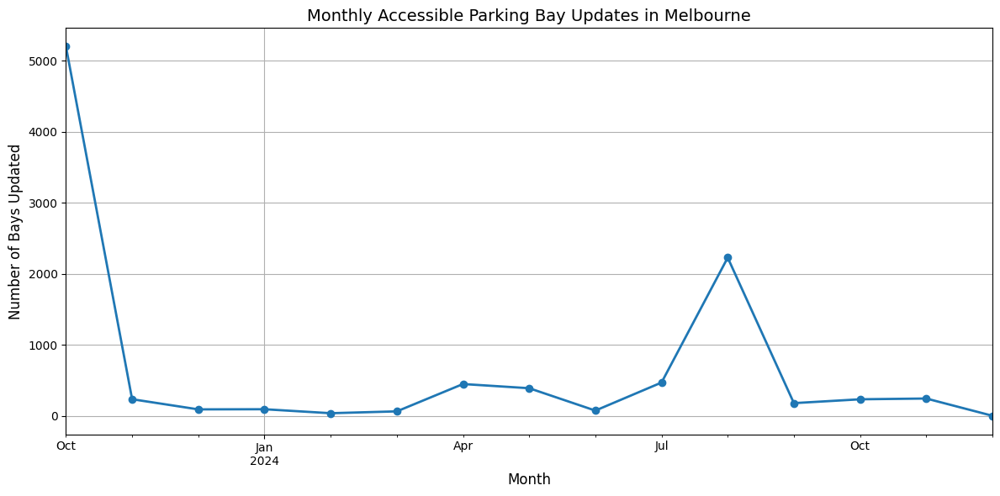

In [49]:
import matplotlib.pyplot as plt

# Plotting
plt.figure(figsize=(12, 6))
monthly_counts.plot(kind='line', marker='o', linewidth=2)

# Labels and title
plt.title('Monthly Accessible Parking Bay Updates in Melbourne', fontsize=14)
plt.xlabel('Month', fontsize=12)
plt.ylabel('Number of Bays Updated', fontsize=12)
plt.grid(True)
plt.tight_layout()
plt.show()


# RT ACCESSIBLE PARKING – 1.6P

### Comparing Accessibility Coverage with High-Demand Parking Zones

This visualisation overlays two layers:

1. Accessible parking bay locations  
2. Parking meter density (as a proxy for parking demand)

By combining these, we can identify areas where demand is high but accessible infrastructure is missing — helping planners prioritise improvements where they’re most needed.


In [50]:
# Accessible bays (from df_bays used earlier)
accessible_coords = df_bays[['latitude', 'longitude']].dropna()
accessible_coords = accessible_coords.astype(float)

# Parking meters (from df_map_meters or df_meters)
meter_coords = df_meters[['latitude', 'longitude']].dropna()
meter_coords = meter_coords.astype(float)

print("Accessible Bays:", accessible_coords.shape[0])
print("Parking Meters:", meter_coords.shape[0])


Accessible Bays: 10000
Parking Meters: 1293


## Step 2: Display Multi-Layer Map of Accessibility and Demand

This map shows two layers:

- **Blue markers**: accessible parking bays (individual markers)
- **Red heatmap**: areas with a high density of parking meters (demand zones)

This lets us visually identify areas with high parking activity but low accessible bay coverage.


In [52]:
from folium.plugins import HeatMap

# Create base map
m = folium.Map(location=[-37.8136, 144.9631], zoom_start=14, tiles="CartoDB positron")

# Add demand heatmap (meter density)
heat_data = meter_coords[['latitude', 'longitude']].values.tolist()
HeatMap(heat_data, radius=10, blur=15, gradient={0.4: 'orange', 0.7: 'red'}).add_to(m)

# Add accessible bay markers
for _, row in accessible_coords.iterrows():
    folium.CircleMarker(
        location=[row['latitude'], row['longitude']],
        radius=3,
        color='blue',
        fill=True,
        fill_opacity=0.8
    ).add_to(m)

# Show map
m


## Create an IpyWidgets app layout

Feature still to come
